# 加载数据

In [254]:
import pandas as pd
import numpy as np
import sklearn
import seaborn as sns
import matplotlib.pyplot as plt
import os

In [255]:
data = pd.read_csv("winequalityN.csv")

In [256]:
data.head()

,type,fixed acidity,volatile acidity,citric acid,residual sugar,chlorides,free sulfur dioxide,total sulfur dioxide,density,pH,sulphates,alcohol,quality
0,white,7.0,0.27,0.36,20.7,0.045,45.0,170.0,1.0010,3.00,0.45,8.8,6
1,white,6.3,0.30,0.34,1.6,0.049,14.0,132.0,0.9940,3.30,0.49,9.5,6
2,white,8.1,0.28,0.40,6.9,0.050,30.0,97.0,0.9951,3.26,0.44,10.1,6
3,white,7.2,0.23,0.32,8.5,0.058,47.0,186.0,0.9956,3.19,0.40,9.9,6
4,white,7.2,0.23,0.32,8.5,0.058,47.0,186.0,0.9956,3.19,0.40,9.9,6


In [257]:
data.corr

<bound method DataFrame.corr of        type  fixed acidity  volatile acidity  citric acid  residual sugar  \
0     white            7.0             0.270         0.36            20.7   
1     white            6.3             0.300         0.34             1.6   
2     white            8.1             0.280         0.40             6.9   
3     white            7.2             0.230         0.32             8.5   
4     white            7.2             0.230         0.32             8.5   
...     ...            ...               ...          ...             ...   
6492    red            6.2             0.600         0.08             2.0   
6493    red            5.9             0.550         0.10             2.2   
6494    red            6.3             0.510         0.13             2.3   
6495    red            5.9             0.645         0.12             2.0   
6496    red            6.0             0.310         0.47             3.6   

      chlorides  free sulfur dioxide  total

In [258]:
data.columns

Index(['type', 'fixed acidity', 'volatile acidity', 'citric acid',
       'residual sugar', 'chlorides', 'free sulfur dioxide',
       'total sulfur dioxide', 'density', 'pH', 'sulphates', 'alcohol',
       'quality'],
      dtype='object')

In [259]:
data['quality'].unique()

array([6, 5, 7, 8, 4, 3, 9], dtype=int64)

# 数据可视化

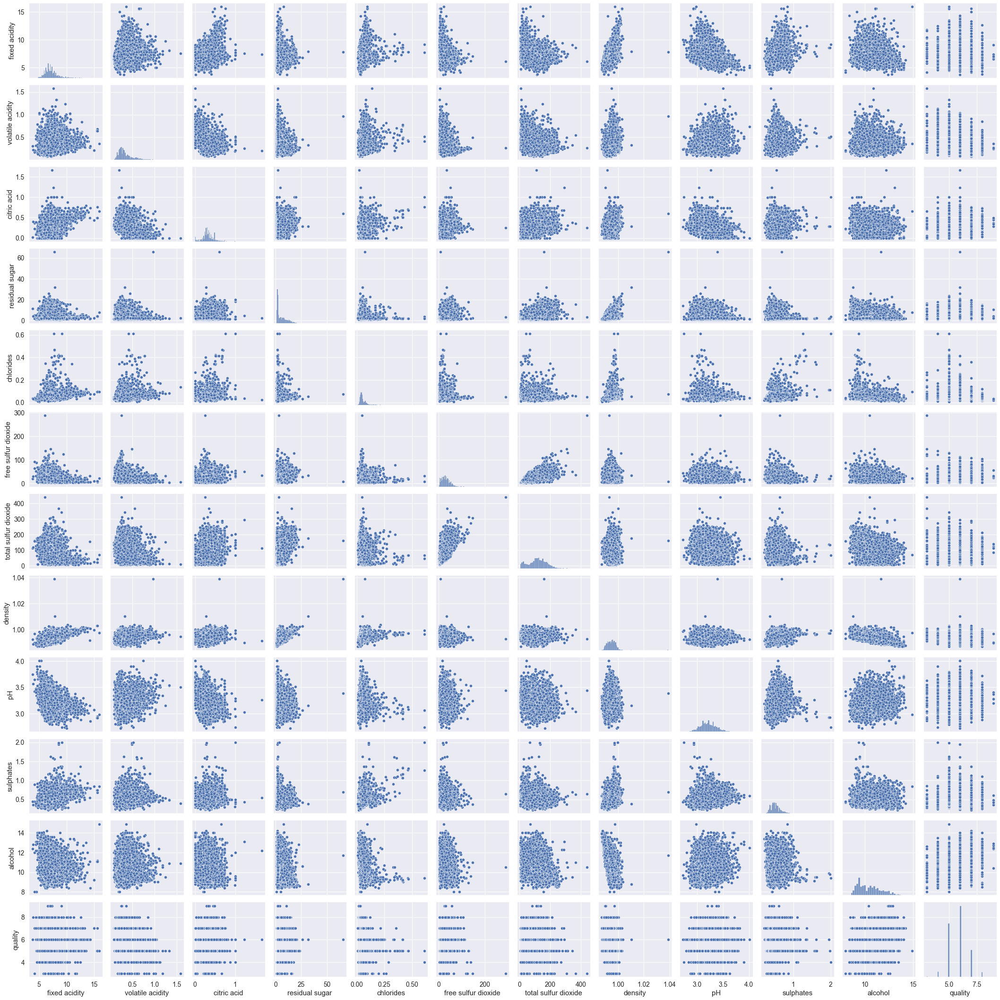

In [185]:
#Check correleation between the variables using Seaborn's pairplot. 
sns.pairplot(data)

In [260]:
#count of each target variable
from collections import Counter
Counter(data['type'])

Counter({'white': 4898, 'red': 1599})

In [261]:
data.describe()

,fixed acidity,volatile acidity,citric acid,residual sugar,chlorides,free sulfur dioxide,total sulfur dioxide,density,pH,sulphates,alcohol,quality
count,6487.000000,6489.000000,6494.000000,6495.000000,6495.000000,6497.000000,6497.000000,6497.000000,6488.000000,6493.000000,6497.000000,6497.000000
mean,7.216579,0.339691,0.318722,5.444326,0.056042,30.525319,115.744574,0.994697,3.218395,0.531215,10.491801,5.818378
std,1.296750,0.164649,0.145265,4.758125,0.035036,17.749400,56.521855,0.002999,0.160748,0.148814,1.192712,0.873255
min,3.800000,0.080000,0.000000,0.600000,0.009000,1.000000,6.000000,0.987110,2.720000,0.220000,8.000000,3.000000
25%,6.400000,0.230000,0.250000,1.800000,0.038000,17.000000,77.000000,0.992340,3.110000,0.430000,9.500000,5.000000
50%,7.000000,0.290000,0.310000,3.000000,0.047000,29.000000,118.000000,0.994890,3.210000,0.510000,10.300000,6.000000
75%,7.700000,0.400000,0.390000,8.100000,0.065000,41.000000,156.000000,0.996990,3.320000,0.600000,11.300000,6.000000
max,15.900000,1.580000,1.660000,65.800000,0.611000,289.000000,440.000000,1.038980,4.010000,2.000000,14.900000,9.000000


C:\Users\tyyyy\anaconda3\lib\site-packages\seaborn\axisgrid.py:1667: UserWarning: The `size` parameter has been renamed to `height`; please update your code.
  warnings.warn(msg, UserWarning)


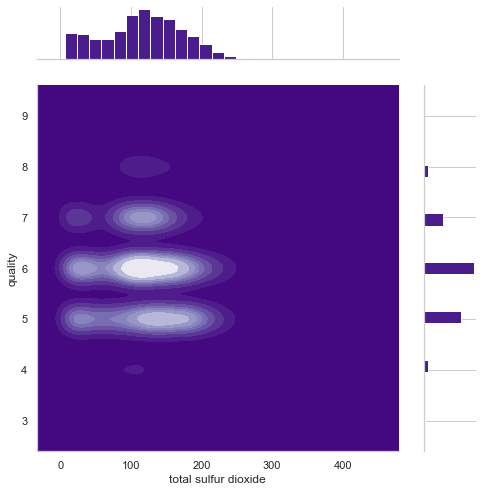

In [262]:
sns.set_theme(style = "whitegrid")
g = sns.JointGrid(data = data, size = 7, x = "total sulfur dioxide", y = "quality", space = 0.5)
g.plot_joint(sns.kdeplot, fill = True, thresh = 0, cmap = "Purples_r")
g.plot_marginals(sns.histplot, color = "#491D8B", alpha = 1, bins = 25);

C:\Users\tyyyy\anaconda3\lib\site-packages\seaborn\axisgrid.py:1667: UserWarning: The `size` parameter has been renamed to `height`; please update your code.
  warnings.warn(msg, UserWarning)


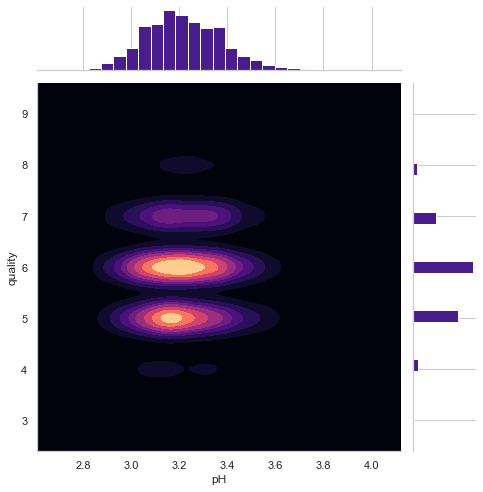

In [263]:
g = sns.JointGrid(data = data, x = "pH", y = "quality", size = 7, space = 0.2)
g.plot_joint(sns.kdeplot, fill = True, thresh = 0, cmap = "magma")
g.plot_marginals(sns.histplot, color = "#491D8B", alpha = 1, bins = 25);

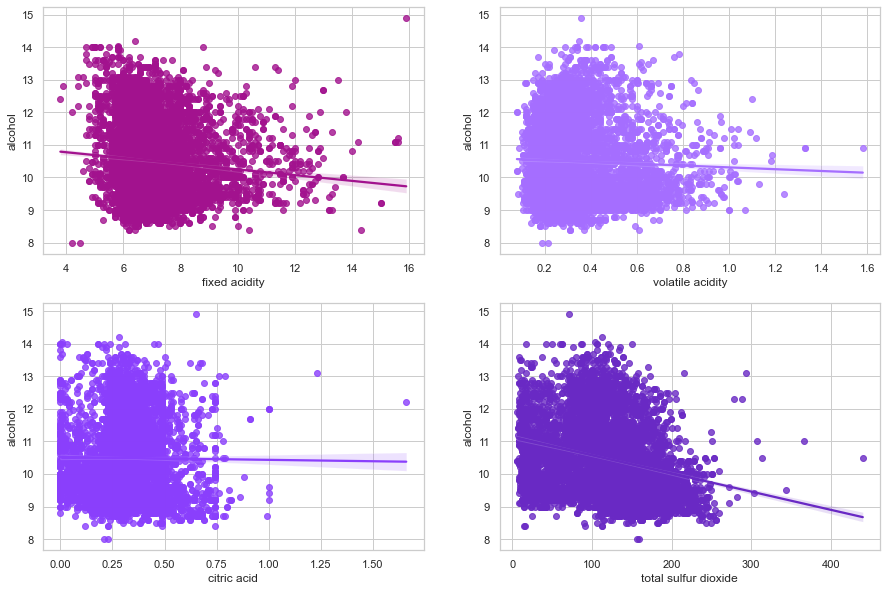

In [264]:
fig, axes = plt.subplots(2, 2, figsize = (15, 10))
axes = axes.flatten()

sns.regplot(ax = axes[0], x = "fixed acidity", y = "alcohol", data = data, color = "#A2128E");
sns.regplot(ax = axes[1], x = "volatile acidity", y = "alcohol", data = data, color = "#A56EFF");
sns.regplot(ax = axes[2], x = "citric acid", y = "alcohol", data = data, color = "#8A3FFC");
sns.regplot(ax = axes[3], x = "total sulfur dioxide", y = "alcohol", data = data, color = "#6929C4");

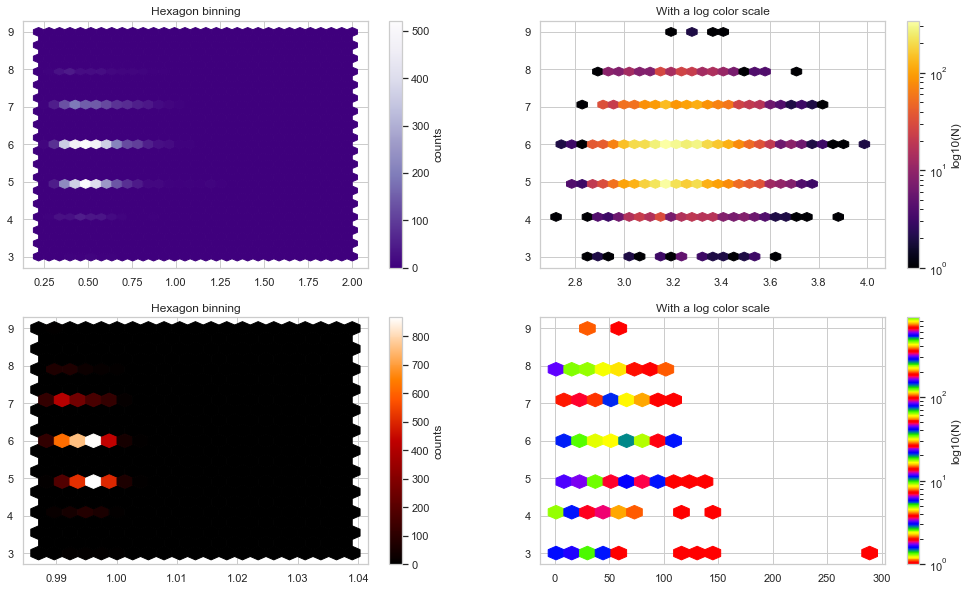

In [265]:
fig, ([ax0, ax1], [ax2, ax3]) = plt.subplots(nrows = 2, ncols = 2, figsize = (17, 10))

hb = ax0.hexbin(data["sulphates"], data["quality"], gridsize = 30, cmap = 'Purples_r')
ax0.set_title("Hexagon binning")
cb = fig.colorbar(hb, ax = ax0, label = 'counts')


hb = ax1.hexbin(data["pH"], data["quality"], gridsize = 30, bins = 'log', cmap = 'inferno')
ax1.set_title("With a log color scale")
cb = fig.colorbar(hb, ax = ax1, label = 'log10(N)')


hb = ax2.hexbin(data["density"], data["quality"], gridsize = 20, cmap = 'gist_heat')
ax2.set_title("Hexagon binning")
cb = fig.colorbar(hb, ax = ax2, label = 'counts')

hb = ax3.hexbin(data["free sulfur dioxide"], data["quality"], gridsize = 20, bins = 'log',
                cmap = 'prism')
ax3.set_title("With a log color scale")
cb = fig.colorbar(hb, ax = ax3, label = 'log10(N)')

plt.show()

In [19]:
import pandas_profiling
pandas_profiling.ProfileReport(data)

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

In [20]:
import sweetviz as sv

report = sv.analyze(data)
report.show_html()

                                             |                                             | [  0%]   00:00 ->…

Report SWEETVIZ_REPORT.html was generated! NOTEBOOK/COLAB USERS: the web browser MAY not pop up, regardless, the report IS saved in your notebook/colab files.


In [21]:
from autoviz.AutoViz_Class import AutoViz_Class
AV = AutoViz_Class()
data_AV = AV.AutoViz('winequalityN.csv',chart_format='html')

Imported v0.1.58. After importing, execute '%matplotlib inline' to display charts in Jupyter.
    AV = AutoViz_Class()
    dfte = AV.AutoViz(filename, sep=',', depVar='', dfte=None, header=0, verbose=1, lowess=False,
               chart_format='svg',max_rows_analyzed=150000,max_cols_analyzed=30, save_plot_dir=None)
Update: verbose=0 displays charts in your local Jupyter notebook.
        verbose=1 additionally provides EDA data cleaning suggestions. It also displays charts.
        verbose=2 does not display charts but saves them in AutoViz_Plots folder in local machine.
        chart_format='bokeh' displays charts in your local Jupyter notebook.
        chart_format='server' displays charts in your browser: one tab for each chart type
        chart_format='html' silently saves interactive HTML files in your local machine
Shape of your Data Set loaded: (6497, 13)
#######################################################################################
######################## C L A S S 

,Nuniques,dtype,Nulls,Nullpercent,NuniquePercent,Value counts Min,Data cleaning improvement suggestions
density,998,float64,0,0.000000,15.360936,0,
residual sugar,316,float64,2,0.030783,4.863783,0,"fill missing, skewed: cap or drop outliers"
total sulfur dioxide,276,float64,0,0.000000,4.248115,0,
chlorides,214,float64,2,0.030783,3.293828,0,"fill missing, highly skewed: drop outliers or do box-cox transform"
volatile acidity,187,float64,8,0.123134,2.878252,0,"fill missing, skewed: cap or drop outliers"
free sulfur dioxide,135,float64,0,0.000000,2.077882,0,skewed: cap or drop outliers
sulphates,111,float64,4,0.061567,1.708481,0,"fill missing, skewed: cap or drop outliers"
alcohol,111,float64,0,0.000000,1.708481,0,
pH,108,float64,9,0.138525,1.662306,0,fill missing
fixed acidity,106,float64,10,0.153917,1.631522,0,"fill missing, skewed: cap or drop outliers"


    13 Predictors classified...
        No variables removed since no ID or low-information variables found in data set
No scatter plots with depVar when no depVar is given.
Saving pair_scatters in HTML format
Saving distplots_nums in HTML format                                                                                   
Saving violinplots in HTML format                                                                                      
No date vars could be found in data set
Saving heatmaps in HTML format
Saving cat_var_plots in HTML format
Time to run AutoViz (in seconds) = 19                                                                                  


In [22]:
import dtale
import pandas as pd
d = dtale.show(data)
d.open_browser()

# 数据处理

In [266]:
#check null
data.isnull().sum() 

type                     0
fixed acidity           10
volatile acidity         8
citric acid              3
residual sugar           2
chlorides                2
free sulfur dioxide      0
total sulfur dioxide     0
density                  0
pH                       9
sulphates                4
alcohol                  0
quality                  0
dtype: int64

In [267]:
data = data.dropna(axis=0,how='any')

In [268]:
data

,type,fixed acidity,volatile acidity,citric acid,residual sugar,chlorides,free sulfur dioxide,total sulfur dioxide,density,pH,sulphates,alcohol,quality
0,white,7.0,0.270,0.36,20.7,0.045,45.0,170.0,1.00100,3.00,0.45,8.8,6
1,white,6.3,0.300,0.34,1.6,0.049,14.0,132.0,0.99400,3.30,0.49,9.5,6
2,white,8.1,0.280,0.40,6.9,0.050,30.0,97.0,0.99510,3.26,0.44,10.1,6
3,white,7.2,0.230,0.32,8.5,0.058,47.0,186.0,0.99560,3.19,0.40,9.9,6
4,white,7.2,0.230,0.32,8.5,0.058,47.0,186.0,0.99560,3.19,0.40,9.9,6
...,...,...,...,...,...,...,...,...,...,...,...,...,...
6491,red,6.8,0.620,0.08,1.9,0.068,28.0,38.0,0.99651,3.42,0.82,9.5,6
6492,red,6.2,0.600,0.08,2.0,0.090,32.0,44.0,0.99490,3.45,0.58,10.5,5
6494,red,6.3,0.510,0.13,2.3,0.076,29.0,40.0,0.99574,3.42,0.75,11.0,6
6495,red,5.9,0.645,0.12,2.0,0.075,32.0,44.0,0.99547,3.57,0.71,10.2,5


In [269]:
data.isnull().sum() 

type                    0
fixed acidity           0
volatile acidity        0
citric acid             0
residual sugar          0
chlorides               0
free sulfur dioxide     0
total sulfur dioxide    0
density                 0
pH                      0
sulphates               0
alcohol                 0
quality                 0
dtype: int64

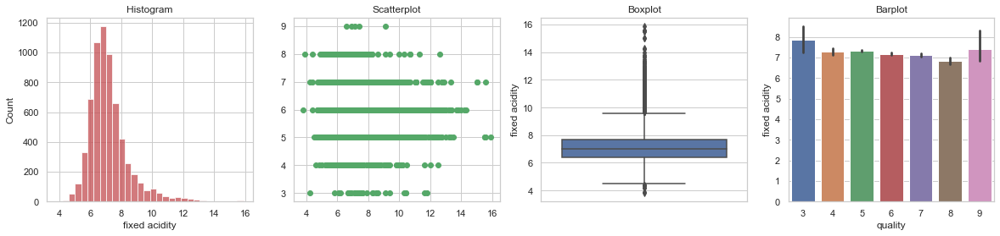

In [270]:
diagnostic_plots(data,'fixed acidity','quality')

In [271]:
from feature_engine.outliers import Winsorizer
windsoriser = Winsorizer(capping_method='iqr', 
                          tail='both', # cap left, right or both tails 
                          fold=1.5,
                          variables=['fixed acidity', 'volatile acidity', 'citric acid', 'residual sugar',
                                     'chlorides', 'free sulfur dioxide', 'total sulfur dioxide', 'density',
                                     'pH', 'sulphates'])

In [272]:
windsoriser.fit(data)

Winsorizer(capping_method='iqr', fold=1.5, tail='both',
           variables=['fixed acidity', 'volatile acidity', 'citric acid',
                      'residual sugar', 'chlorides', 'free sulfur dioxide',
                      'total sulfur dioxide', 'density', 'pH', 'sulphates'])

In [273]:
data = windsoriser.transform(data)

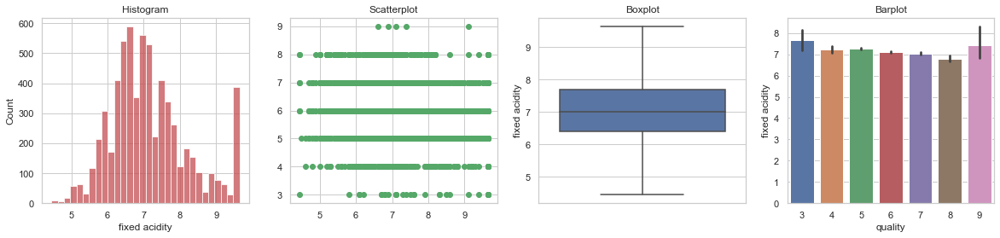

In [274]:
diagnostic_plots(data,'fixed acidity','quality')

In [275]:
cols = ['fixed acidity', 'volatile acidity', 'residual sugar',
       'chlorides', 'free sulfur dioxide', 'total sulfur dioxide',
       'sulphates', 'alcohol']

In [276]:
#deal pianyi
import feature_engine.transformation as vt
lt = vt.LogTransformer(variables = cols)

lt.fit(data)


LogTransformer(variables=['fixed acidity', 'volatile acidity', 'residual sugar',
                          'chlorides', 'free sulfur dioxide',
                          'total sulfur dioxide', 'sulphates', 'alcohol'])

In [277]:
#aniother method deal pianyi
import feature_engine.transformation as vt
bt = vt.BoxCoxTransformer(variables = cols)

bt.fit(data)

BoxCoxTransformer(variables=['fixed acidity', 'volatile acidity',
                             'residual sugar', 'chlorides',
                             'free sulfur dioxide', 'total sulfur dioxide',
                             'sulphates', 'alcohol'])

In [278]:
data = bt.transform(data)

# 划分训练集测试集

In [317]:
x = data.drop('type', axis=1)
y = data['type']

In [318]:
x

,fixed acidity,volatile acidity,citric acid,residual sugar,chlorides,free sulfur dioxide,total sulfur dioxide,density,pH,sulphates,alcohol,quality
0,1.150862,-1.431440,0.36,2.241603,-3.832680,12.036303,100.893356,1.00100,3.00,-0.840760,0.540848,6
1,1.116828,-1.306719,0.34,0.450783,-3.705126,5.674142,80.641196,0.99400,3.30,-0.746946,0.542234,6
2,1.194607,-1.388190,0.40,1.633094,-3.675075,9.377673,61.325249,0.99510,3.26,-0.865688,0.543212,6
3,1.159605,-1.624664,0.32,1.777980,-3.456748,12.356241,109.243599,0.99560,3.19,-0.972213,0.542904,6
4,1.159605,-1.624664,0.32,1.777980,-3.456748,12.356241,109.243599,0.99560,3.19,-0.972213,0.542904,6
...,...,...,...,...,...,...,...,...,...,...,...,...
6491,1.141711,-0.493706,0.08,0.606368,-3.227466,8.978632,26.383191,0.99651,3.42,-0.200994,0.542234,6
6492,1.111470,-0.528746,0.08,0.651887,-2.834969,9.764169,30.148424,0.99490,3.45,-0.564175,0.543778,5
6494,1.116828,-0.704712,0.13,0.773816,-3.069979,9.179800,27.646031,0.99574,3.42,-0.293047,0.544406,6
6495,1.094532,-0.451667,0.12,0.651887,-3.088612,9.764169,30.148424,0.99547,3.57,-0.350112,0.543360,5


In [319]:
y

0       white
1       white
2       white
3       white
4       white
        ...  
6491      red
6492      red
6494      red
6495      red
6496      red
Name: type, Length: 6463, dtype: object

In [320]:
x_train, x_test, y_train, y_test = train_test_split(x, 
                                                  y, 
                                                  test_size=0.1)

print(x_train.shape)
print(x_test.shape)
print(y_train.shape)
print(y_test.shape)

(5816, 12)
(647, 12)
(5816,)
(647,)


In [321]:
x.shape, y.shape

((6463, 12), (6463,))

In [322]:
x_arr = np.array(x)
x_arr.shape, x.shape

((6463, 12), (6463, 12))

In [323]:
x_arr

array([[ 1.15086181, -1.43144027,  0.36      , ..., -0.84076012,
         0.54084808,  6.        ],
       [ 1.11682818, -1.30671947,  0.34      , ..., -0.74694641,
         0.54223376,  6.        ],
       [ 1.19460735, -1.38819048,  0.4       , ..., -0.86568832,
         0.54321204,  6.        ],
       ...,
       [ 1.11682818, -0.70471203,  0.13      , ..., -0.29304669,
         0.54440643,  6.        ],
       [ 1.09453184, -0.45166731,  0.12      , ..., -0.35011168,
         0.54335952,  5.        ],
       [ 1.10032799, -1.26826295,  0.47      , ..., -0.42676863,
         0.54440643,  6.        ]])

In [324]:
from sklearn.preprocessing import LabelEncoder
encoder = LabelEncoder()
encoder.fit(y)
encoded_y = encoder.transform(y)

In [325]:
labelled_y = to_categorical(encoded_y)

In [326]:
labelled_y.shape

(6463, 2)

In [327]:
# y = to_categorical(data['Reviews'].values)  

In [328]:
x_train, x_test, y_train, y_test = train_test_split(x, 
                                                  labelled_y, 
                                                  test_size=0.1)
#                                                   random_state=123)

print(x_train.shape)
print(x_test.shape)
print(y_train.shape)
print(y_test.shape)

(5816, 12)
(647, 12)
(5816, 2)
(647, 2)


In [329]:
x_test

,fixed acidity,volatile acidity,citric acid,residual sugar,chlorides,free sulfur dioxide,total sulfur dioxide,density,pH,sulphates,alcohol,quality
4739,1.069682,-2.077655,0.31,0.179380,-4.689659,9.572413,44.645470,0.98980,3.330,-0.865688,0.545112,6
5565,1.242298,-1.160831,0.45,0.651887,-2.963712,2.963273,11.066823,0.99880,2.940,-0.426769,0.541676,6
3794,1.069682,-1.572970,0.45,0.506217,-3.799621,7.691341,70.248186,0.99224,3.220,-0.769568,0.543060,5
2623,1.127148,-1.928209,0.41,2.112312,-4.050283,12.356241,79.013398,0.99678,3.280,-0.335511,0.543503,7
215,1.088577,-1.476546,0.24,1.831560,-3.866581,13.575131,91.379987,0.99610,3.310,-1.030082,0.542053,5
...,...,...,...,...,...,...,...,...,...,...,...,...
4625,1.201553,-0.748619,0.23,1.606887,-4.262812,2.963273,94.566055,0.99344,3.050,-0.769568,0.544636,5
5166,1.146339,-0.642386,0.04,0.997373,-3.051622,3.371733,19.272078,0.99870,3.635,-0.158236,0.542053,6
6276,1.159605,-0.842872,0.15,0.651887,-3.033532,4.452689,19.931796,0.99609,3.290,-0.703227,0.542904,6
5917,1.150862,-0.726417,0.14,0.557933,-3.033532,4.452689,16.601068,0.99636,3.530,-0.510275,0.543643,5


In [330]:
y_test

array([[0., 1.],
       [1., 0.],
       [0., 1.],
       ...,
       [1., 0.],
       [1., 0.],
       [0., 1.]], dtype=float32)

# 建模

In [331]:
from tensorflow.keras.layers import Dense, Conv1D, MaxPooling1D, Activation, Dropout
from tensorflow.keras.models import Sequential
from tensorflow.keras.callbacks import EarlyStopping
from tensorflow.keras.utils import to_categorical
def naural_natwork():
    model = Sequential()
    model.add(Dense(256, activation='relu', input_shape=(x_arr.shape[1],)))
    model.add(Dense(128, activation='relu'))
    model.add(Dense(2, activation='softmax'))
    
    return model

In [332]:
model = naural_natwork()

# compiling the model
model.compile(optimizer='adam', 
              loss='categorical_crossentropy', 
              metrics=['accuracy'])

# setting a callback for controlling model's performance
callback = EarlyStopping(monitor='val_accuracy', 
                                   mode='max', # don't minimize the accuracy!
                                   patience=10,
                                   restore_best_weights=True)


# fitting the model to training data
model.fit(x_train, y_train, 
          epochs=100, 
          validation_data=(x_test, y_test), verbose=1)

Epoch 1/100
182/182 [==============================] - 1s 2ms/step - loss: 0.2814 - accuracy: 0.9099 - val_loss: 0.1474 - val_accuracy: 0.9521
Epoch 2/100
182/182 [==============================] - 0s 1ms/step - loss: 0.1494 - accuracy: 0.9496 - val_loss: 0.0932 - val_accuracy: 0.9629
Epoch 3/100
182/182 [==============================] - 0s 1ms/step - loss: 0.0927 - accuracy: 0.9704 - val_loss: 0.0619 - val_accuracy: 0.9784
Epoch 4/100
182/182 [==============================] - 0s 1ms/step - loss: 0.0705 - accuracy: 0.9780 - val_loss: 0.0501 - val_accuracy: 0.9845
Epoch 5/100
182/182 [==============================] - 0s 1ms/step - loss: 0.0510 - accuracy: 0.9866 - val_loss: 0.0524 - val_accuracy: 0.9845
Epoch 6/100
182/182 [==============================] - 0s 1ms/step - loss: 0.1029 - accuracy: 0.9747 - val_loss: 0.0905 - val_accuracy: 0.9691
Epoch 7/100
182/182 [==============================] - 0s 1ms/step - loss: 0.0669 - accuracy: 0.9799 - val_loss: 0.0495 - val_accuracy: 0.9861

Epoch 58/100
182/182 [==============================] - 0s 1ms/step - loss: 0.0325 - accuracy: 0.9904 - val_loss: 0.0443 - val_accuracy: 0.9845
Epoch 59/100
182/182 [==============================] - 0s 1ms/step - loss: 0.0341 - accuracy: 0.9893 - val_loss: 0.0364 - val_accuracy: 0.9923
Epoch 60/100
182/182 [==============================] - 0s 2ms/step - loss: 0.0300 - accuracy: 0.9904 - val_loss: 0.0527 - val_accuracy: 0.9892
Epoch 61/100
182/182 [==============================] - 0s 1ms/step - loss: 0.0336 - accuracy: 0.9888 - val_loss: 0.0407 - val_accuracy: 0.9892
Epoch 62/100
182/182 [==============================] - 0s 1ms/step - loss: 0.0311 - accuracy: 0.9907 - val_loss: 0.0404 - val_accuracy: 0.9892
Epoch 63/100
182/182 [==============================] - 0s 1ms/step - loss: 0.0295 - accuracy: 0.9916 - val_loss: 0.0376 - val_accuracy: 0.9892
Epoch 64/100
182/182 [==============================] - 0s 1ms/step - loss: 0.0306 - accuracy: 0.9914 - val_loss: 0.0456 - val_accuracy:

In [333]:
model.summary()

Model: "sequential_26"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_95 (Dense)            (None, 256)               3328      
                                                                 
 dense_96 (Dense)            (None, 128)               32896     
                                                                 
 dense_97 (Dense)            (None, 2)                 258       
                                                                 
Total params: 36,482
Trainable params: 36,482
Non-trainable params: 0
_________________________________________________________________


# 评估

In [334]:
hist = model.history.history

In [335]:
hist.keys()

dict_keys(['loss', 'accuracy', 'val_loss', 'val_accuracy'])

In [337]:
acc, val_acc = hist['accuracy'], hist['val_accuracy']
loss = hist['loss']
val_loss = hist['val_loss']

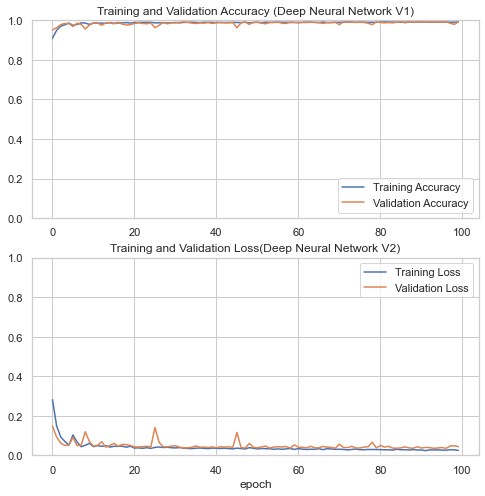

In [338]:
plt.figure(figsize=(8, 8))
plt.subplot(2, 1, 1)
plt.plot(acc, label='Training Accuracy')
plt.plot(val_acc, label='Validation Accuracy')
plt.ylim([0, 1])
plt.legend(loc='lower right')
plt.title('Training and Validation Accuracy (Deep Neural Network V1)')

print('')

plt.subplot(2, 1, 2)
plt.plot(loss, label='Training Loss')
plt.plot(val_loss, label='Validation Loss')
plt.ylim([0, 1.0])

plt.legend(loc='upper right')
plt.title('Training and Validation Loss(Deep Neural Network V2)')
plt.xlabel('epoch')
plt.show()

In [339]:
# evaluate the model
score = model.evaluate(x_test, y_test)
# print accuracies of models 
print("%s: %.2f%%" % (model.metrics_names[1], score[1] * 100))
print('Accuracy of First Deep Neural Network: %.2f' % (score[1]*100))
print('Loss of First Deep Neural Network: %.4f' % (score[0]))

21/21 [==============================] - 0s 948us/step - loss: 0.0437 - accuracy: 0.9923
accuracy: 99.23%
Accuracy of First Deep Neural Network: 99.23
Loss of First Deep Neural Network: 0.0437


In [340]:
y_hat_nn1 = model.predict(x_test)
pred_nn1 = np.argmax(model.predict(x_test), axis=1)
y_test_class_1 = np.argmax(y_test, axis=1)

21/21 [==============================] - 0s 852us/step


In [341]:
from sklearn.metrics import confusion_matrix, classification_report
print('Classification Report of Deep Neural Network 1')
print(classification_report(y_test_class_1, pred_nn1))

Classification Report of Deep Neural Network 1
              precision    recall  f1-score   support

           0       0.98      0.99      0.99       168
           1       1.00      0.99      0.99       479

    accuracy                           0.99       647
   macro avg       0.99      0.99      0.99       647
weighted avg       0.99      0.99      0.99       647

